In [1]:
import sys

sys.path.insert(1, '/Users/users/spirov/ThesisProject/Executable')

import os

import vaex

import numpy as np
import torch
from torch.utils.data import DataLoader
from torch import nn
from NeuralNets import CustomVaexDataset, printNodes, sc, StraightNetwork,Unet
from matplotlib import pyplot as plt

from DataCore import snapshotPath,L


from cycler import cycler


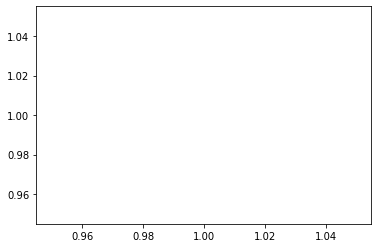

In [2]:


plt.plot([1],[1])

font = {"weight": "normal", "size": 14}
plt.rcParams["axes.linewidth"] = 1.5  # set the value globally
plt.rc("font", **font)
plt.rcParams["axes.facecolor"] = "white"
plt.rcParams["figure.facecolor"] = "white"
_legend = {"frameon": True, "framealpha":0.7}
plt.rc("legend", **_legend)
plt.rcParams["axes.prop_cycle"] = cycler("color",('indigo','b','r','k','#ff7f0e','g'))
plt.show()

In [33]:
dataPath = "/Users/users/spirov/Blk/Nexus Project/Thesis-Project-Cosmic-Web/Data/Testing/"

lengt = len(os.listdir(dataPath))

fil = dataPath + os.listdir(dataPath)[10]

df = vaex.open(fil)
    
c = df.CZ.values
r=df.R.values
f=df.Fi.values
t=df.Th.values

i = np.arange(len(c))    

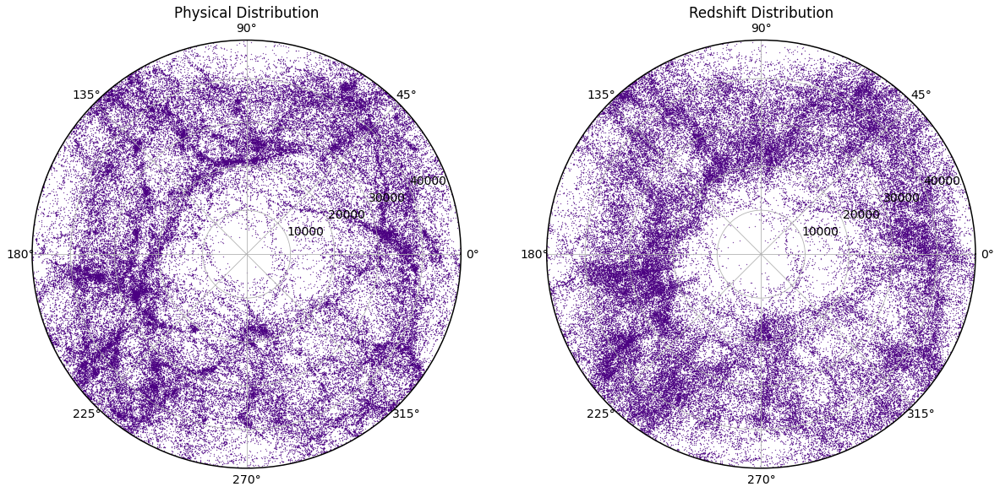

In [39]:
filt = abs(t-np.pi/2)< np.pi
plt.figure(figsize=(20,10))
ax = plt.subplot(121,projection="polar")

plt.scatter(f[filt],r[filt],s=0.1)
plt.ylim(0,3.75e4*1.3)
#plt.colorbar()
plt.title("Physical Distribution")

plt.subplot(122,projection="polar")

plt.scatter(f[filt],c[filt],s=0.1)
plt.ylim(0,3.75e4*1.3)
plt.title("Redshift Distribution")


plt.show()


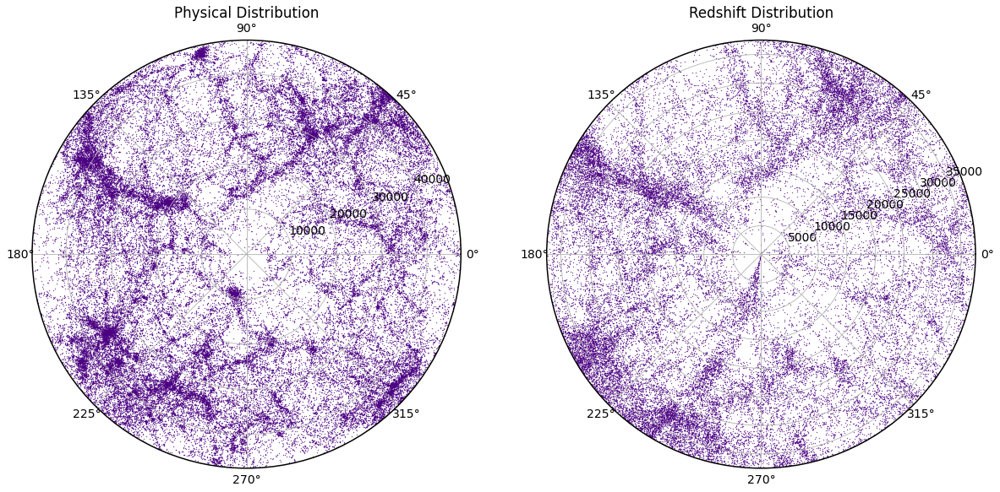

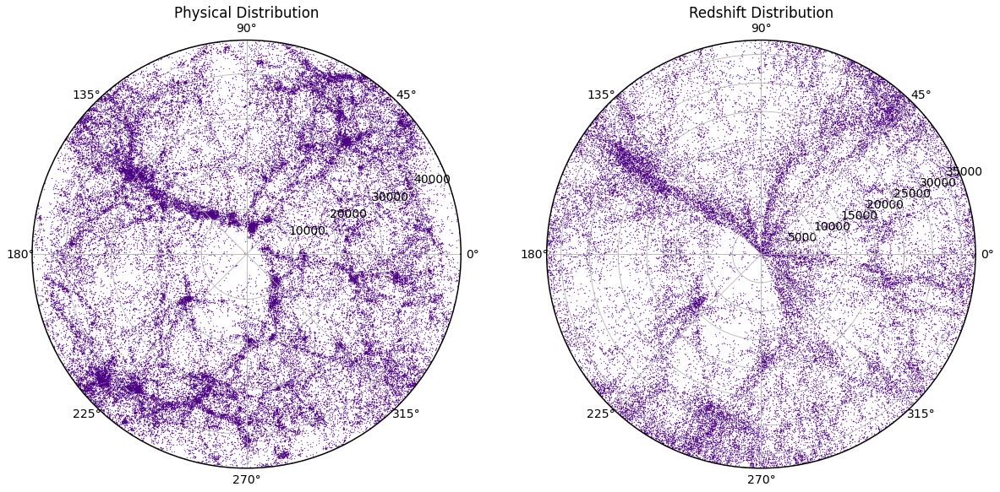

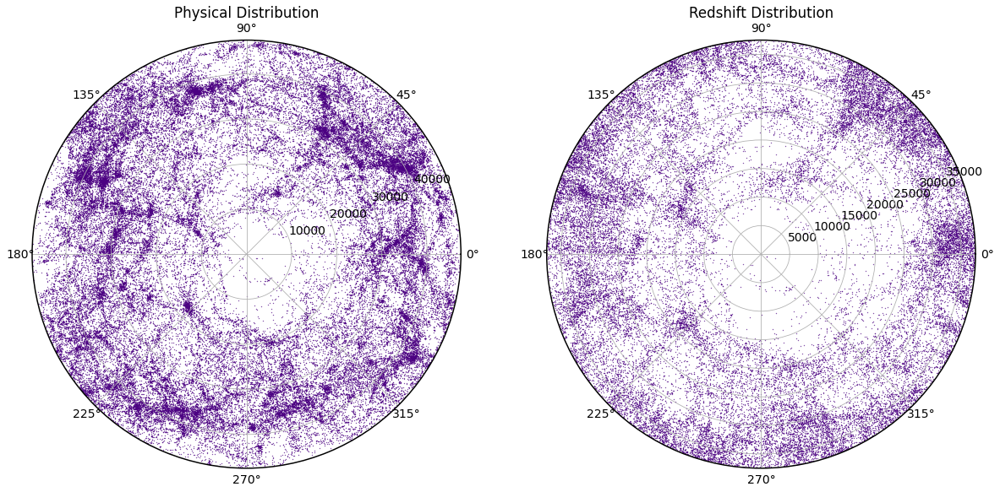

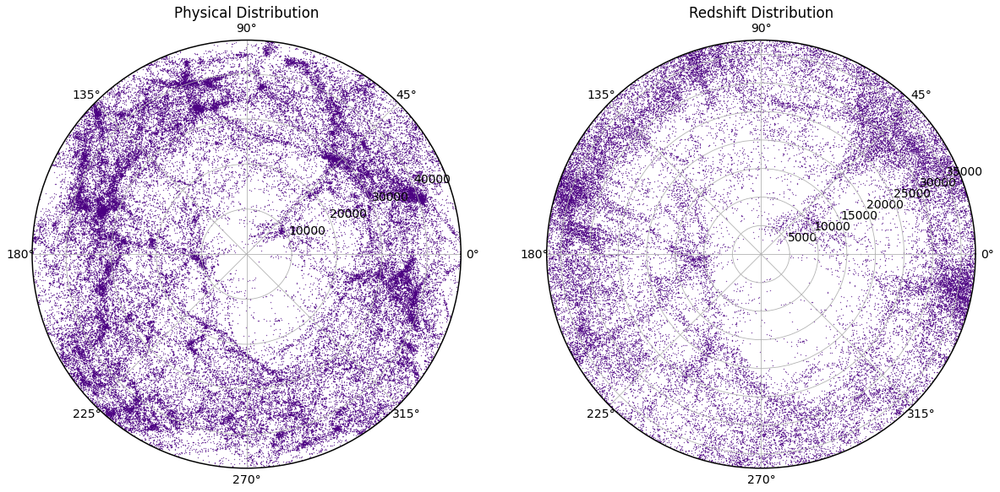

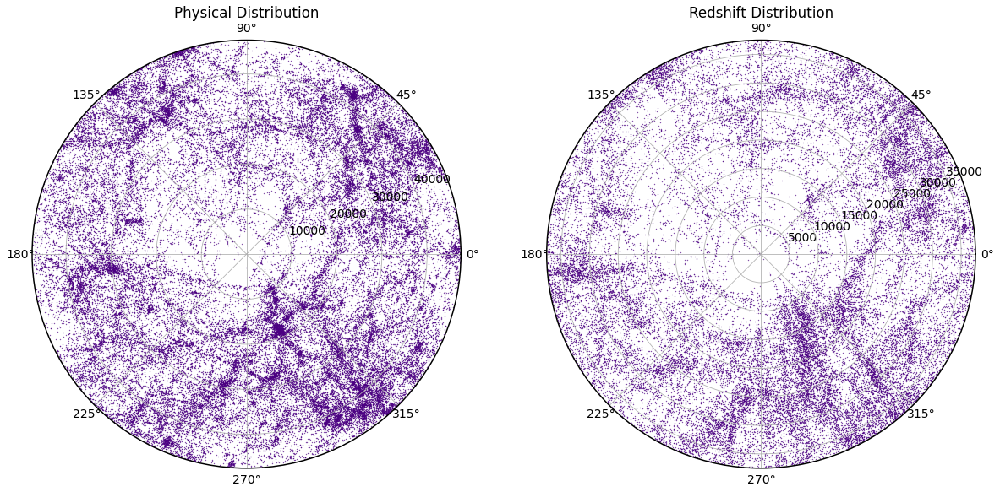

...

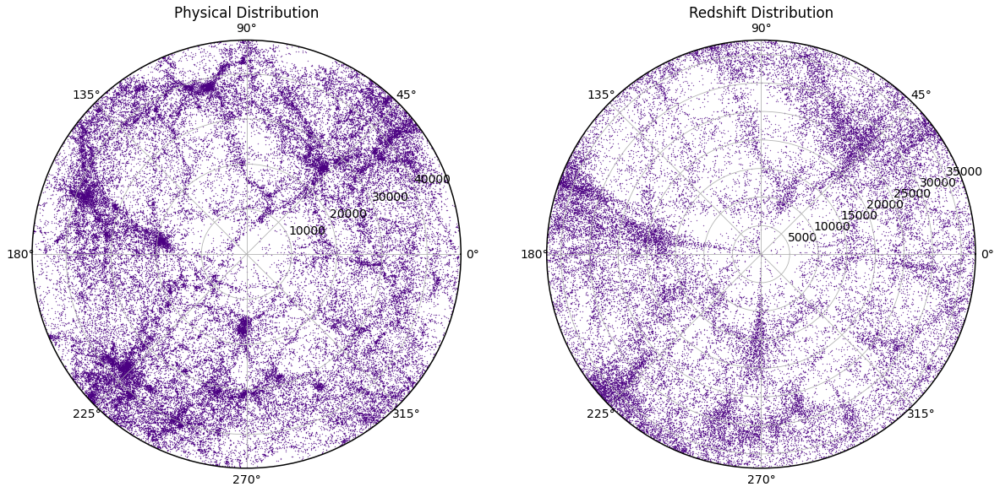

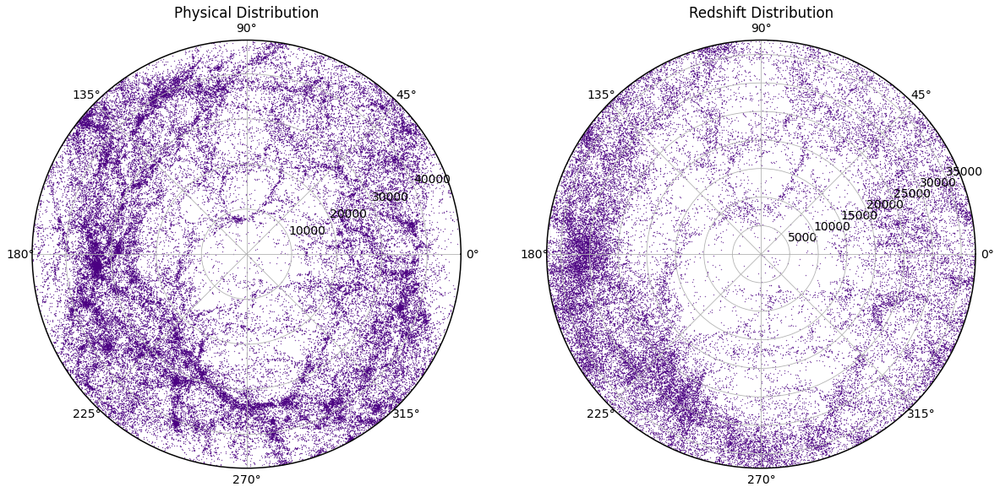

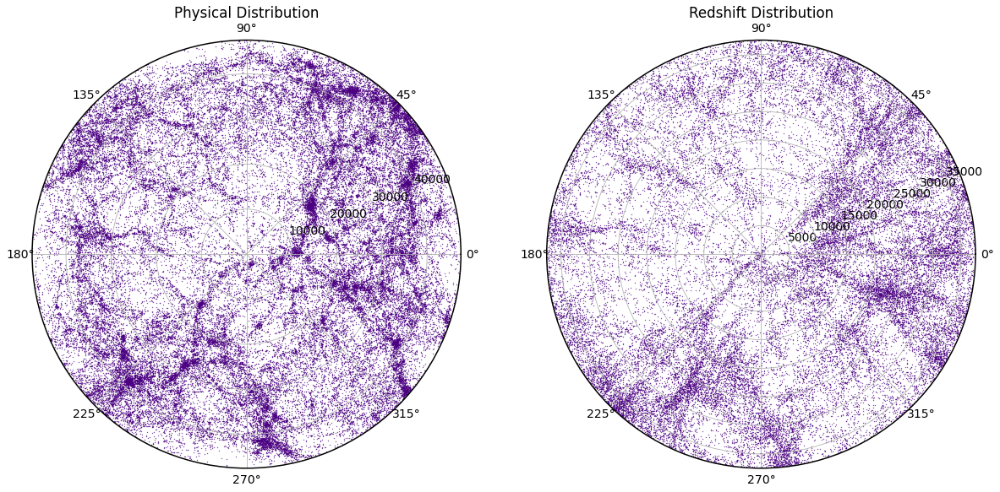

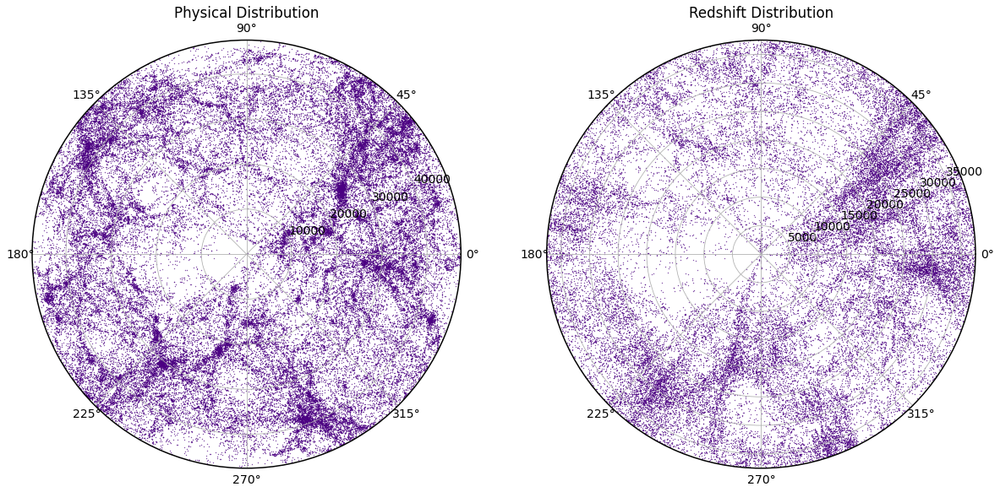

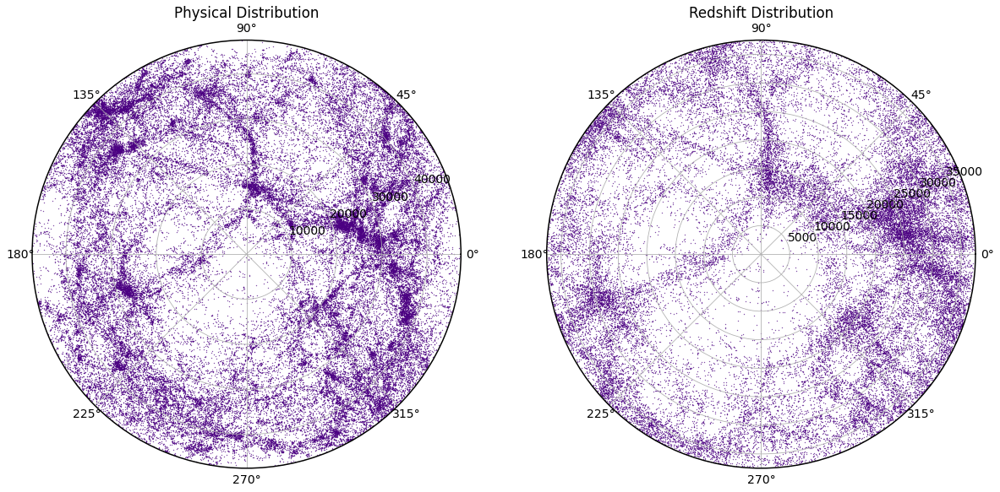

In [8]:
for i in range(lengt)[:30]:
    fil = dataPath + os.listdir(dataPath)[i]
    df = vaex.open(fil)
    c = df.CZ.values
    r=df.R.values
    f=df.Fi.values
    t=df.Th.values
    filt = abs(t-np.pi/2)< np.pi/4
    
    plt.figure(figsize=(20,10))
    ax = plt.subplot(121,projection="polar")

    plt.scatter(f[filt],r[filt],s=0.1)
    plt.ylim(0,4.75e4)
    plt.title("Physical Distribution")

    plt.subplot(122,projection="polar")

    plt.scatter(f[filt],c[filt],s=0.1)
    plt.ylim(0,3.75e4)
    plt.title("Redshift Distribution")


    plt.show()




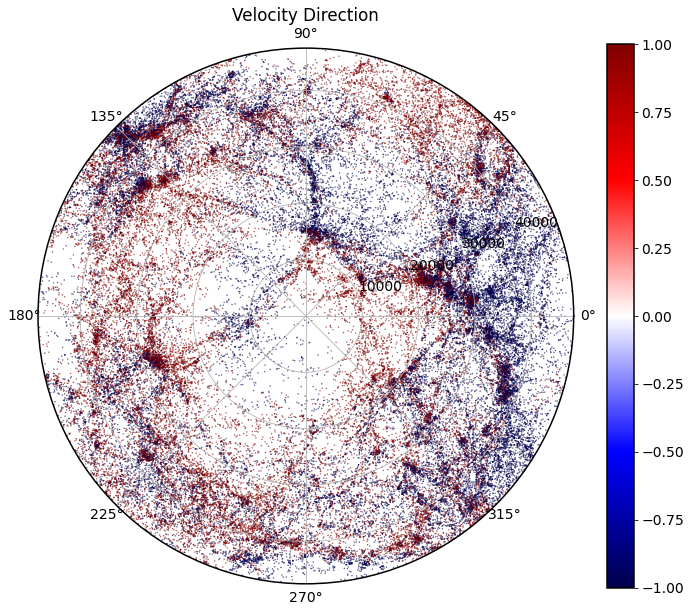

In [9]:
v = (c-r)
plt.figure(figsize=(12,10))
plt.subplot(projection="polar")

plt.scatter(f[filt],r[filt],s=0.1,c=np.sign(v[filt]),cmap="seismic")
plt.ylim(0,4.75e4)
plt.colorbar()
plt.title("Velocity Direction")
plt.show()


# Model

In [10]:
from torch.nn.modules.loss import _Loss


import torch
from torch.utils.data import DataLoader
from torch import nn
from NeuralNets import CustomVaexDataset, printNodes, sc, StraightNetwork,Unet,Stefann

from torch.utils.data import Dataset
from DataCore import snapshotPath,L


In [12]:
torch.set_default_dtype(torch.float64)

GoodPath = "/Users/users/spirov/ThesisProject/Snapshots/FinalModelSnapshot.pt"

sd = torch.load(GoodPath,map_location=torch.device('cpu'))




In [13]:
model =Unet() #BottleneckNetwork() # StraightNetwork() #
model.load_state_dict(sd)


<All keys matched successfully>

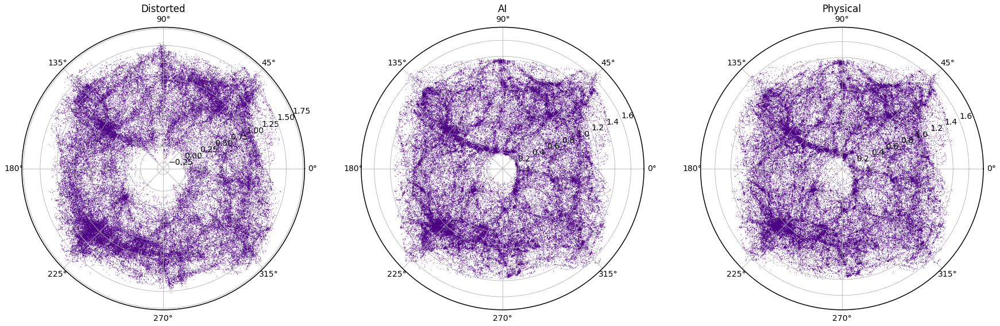

In [41]:
dataset = CustomVaexDataset(dataPath)

img, label = dataset.__getitem__(1)

with torch.no_grad():
    mod = model(img.reshape(1,3,len(label)))
    

plt.figure(figsize=(30,10))
plt.subplot(131,projection="polar")
plt.scatter(img[2],img[0],s=siz,alpha=0.7)
plt.title("Distorted")
plt.subplot(132,projection="polar")
plt.scatter(img[2],mod,s=siz,alpha=0.7)
plt.title("AI")
plt.subplot(133,projection="polar")
plt.scatter(img[2],label,s=siz,alpha=0.7)
plt.title("Physical")
plt.show()


In [31]:
sets = []
for i in range(5):
    img, label = dataset.__getitem__(i*7)

    with torch.no_grad():
        mod = model(img.reshape(1,3,len(label)))
    
    sett = (label,img,mod[0])
    sets.append(sett)
    

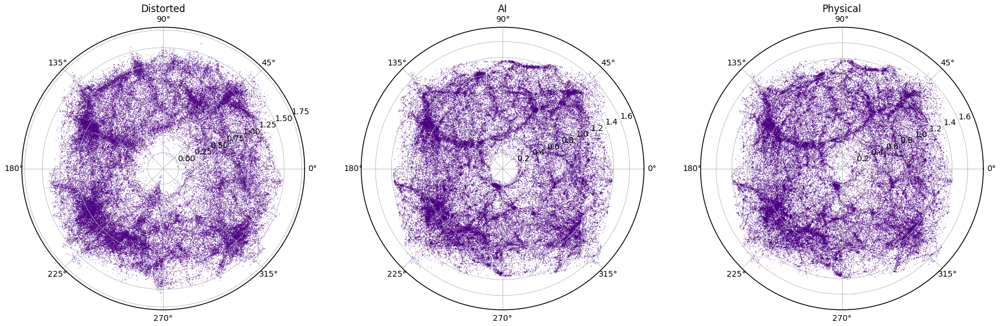

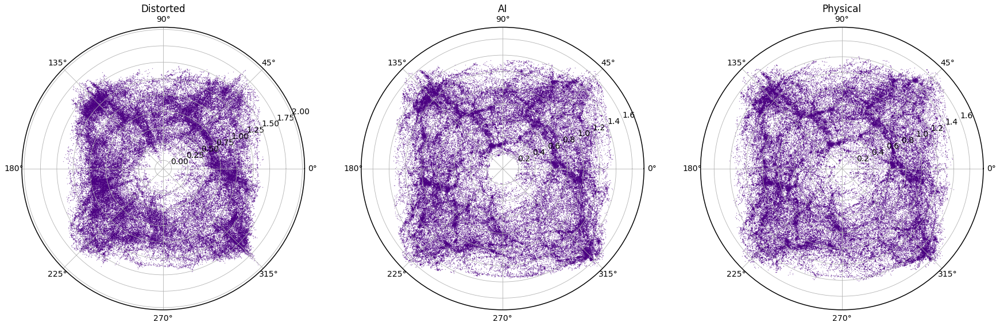

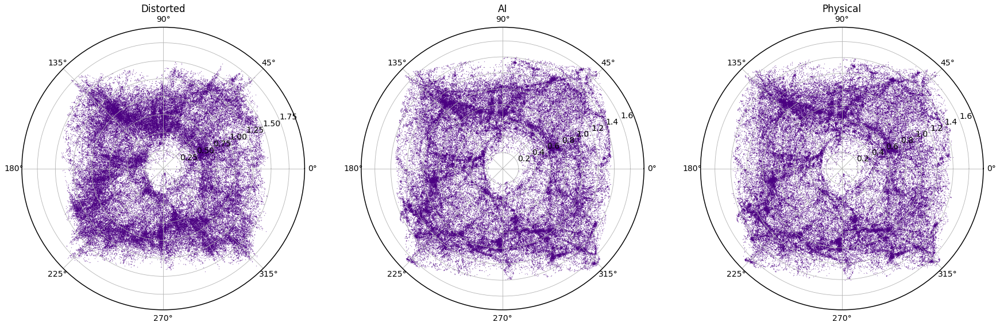

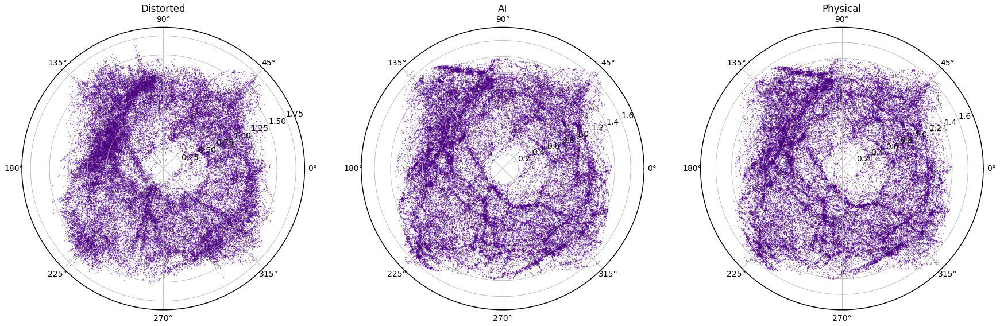

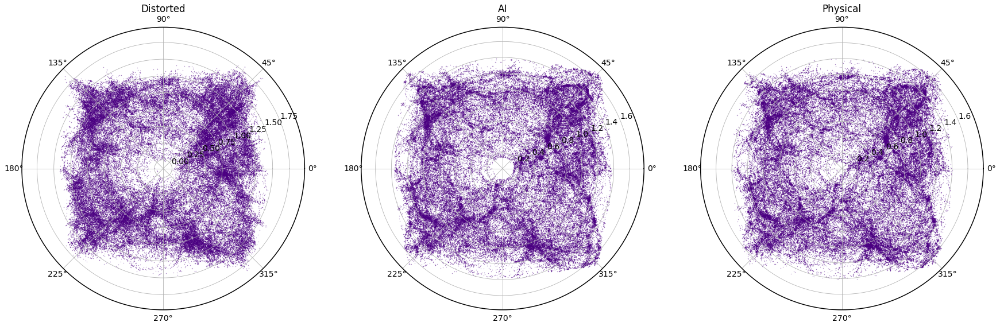

In [32]:
siz = 0.1

for sett in sets:
    img = sett[1]
    label = sett[0]
    mod = sett[2]
    
    plt.figure(figsize=(30,10))
    plt.subplot(131,projection="polar")
    plt.scatter(img[2],img[0],s=siz,alpha=0.7)
    plt.title("Distorted")
    plt.subplot(132,projection="polar")
    plt.scatter(img[2],mod,s=siz,alpha=0.7)
    plt.title("AI")
    plt.subplot(133,projection="polar")
    plt.scatter(img[2],label,s=siz,alpha=0.7)
    plt.title("Physical")
    plt.show()
